# Hypermapping CryptoPunks



<center>
<img src="https://sparklewerk.com/projects/hypermaps/cryptopunks.3100_on_top.png" alt="demo hypermap" />
</center>

<br/>

<center>
<img src="https://sparklewerk.com/images/brands/sparklewerk/sparklewerk_wordmark.png" alt="Sparklewerk wordmark" align="center" />
<br/>
<br/>
<a href="https://colab.research.google.com/github/ManyHands/hypermap/blob/main/notebooks/hypermapping_cryptopunks.ipynb" >
<img src="https://colab.research.google.com/assets/colab-badge.svg" width="20%"/>
</a>
</center>

## Introduction

This is a Jupyter notebook. The above "Open in Colab" button is how to run it for free.

This notebook hypermaps [The CryptoPunks NFT collection](https://www.larvalabs.com/cryptopunks). For more information on hypermaps, please visit [sparklewerk.com](https://sparklewerk.com/projects/hypermaps).

This is free code running on free compute. If you are dissatisfied, we will have customer service get you a full refund. If on the other hand, you have constructive feedback please join the conversation on GitHub: [hypermap issues](https://github.com/ManyHands/hypermap/issues).

## License

Copyright (c) 2022, Many Hands SPC. All Rights Reserved.

Licensed under the MIT License (the "License");

In [ ]:
#@title Copyright (c) 2022, Many Hands SPC. All Rights Reserved.
#
# Licensed under the MIT License (the "License");
#
# MIT License
#
# Copyright (c) 2022, Many Hands SPC
#
# Permission is hereby granted, free of charge, to any person obtaining a copy
# of this software and associated documentation files (the "Software"), to deal
# in the Software without restriction, including without limitation the rights
# to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
# copies of the Software, and to permit persons to whom the Software is
# furnished to do so, subject to the following conditions:
#
# The above copyright notice and this permission notice shall be included in all
# copies or substantial portions of the Software.
#
# THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
# IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
# FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
# AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
# LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
# OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
# SOFTWARE.

## Set up

### Install

UMAP does not come pre-installed on most distros. So, let's.

In [ ]:
# TODO: there are ways to detect if umap-learn has already been installed. 
# Would make this a wee faster on repeat runs.
!pip install umap-learn

     |████████████████████████████████| 86 kB 3.4 MB/s 
     |████████████████████████████████| 1.1 MB 53.6 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.2-py3-none-any.whl size=82708 sha256=b1d954d8ea809ce24d6584b3840828e2a6e31b0c637e7c20f6042a2a71f8b2aa
  Stored in directory: /root/.cache/pip/wheels/84/1b/c6/aaf68a748122632967cef4dffef68224eb16798b6793257d82
  Created wheel for pynndescent: filename=pynndescent-0.5.5-py3-none-any.whl size=52603 sha256=4b13020ec1b2185e39e3ec8a780b6f7a1946e774b458eed2ae855291887ff683
  Stored in directory: /root/.cache/pip/wheels/af/e9/33/04db1436df0757c42fda8ea6796d7a8586e23c85fac355f476
Successfully built umap-learn pynndescent


### Imports


In [ ]:
import numpy as np
import pandas as pd
import os
import umap

from PIL import Image, ImageDraw
from math import trunc
from matplotlib import pyplot as plt
from numpy import asarray
from packaging import version
from skimage.color import rgb2gray

## Data wrangling

The source of data for the OG CryptoPunks is [punks.png](https://raw.githubusercontent.com/larvalabs/cryptopunks/master/punks.png), a single PNG file, a sort of sprite sheet (as such, we need some data wrangling helpers to extract individual punk images from that sprite sheet).

So, first copy that file to be a sibling of this notebook and rename it `og_punks_10000.png`.

In [ ]:
!wget -O og_punks_10000.png https://raw.githubusercontent.com/larvalabs/cryptopunks/master/punks.png

--2022-01-18 08:43:17--  https://raw.githubusercontent.com/larvalabs/cryptopunks/master/punks.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.108.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 848174 (828K) [image/png]
Saving to: ‘og_punks_10000.png’

og_punks_10000.png  100%[===================>] 828.29K  --.-KB/s    in 0.02s   

2022-01-18 08:43:17 (33.6 MB/s) - ‘og_punks_10000.png’ saved [848174/848174]



In [ ]:
!ls

og_punks_10000.png  sample_data


In [ ]:
og_punks_filename = 'og_punks_10000.png'
og_punks = Image.open(og_punks_filename) 

In [ ]:
def get_cropbox(punk_id: int):
    '''
    The punk_id parameter is a punk's global ID, an integer:
      https://www.larvalabs.com/cryptopunks

    This assumes punks are all in a single "spritesheet" PNG 
    image, each 24x24 pixels, 100 per row. 
    10,000 in total i.e. 100 rows and 100 columns.
    '''
    punks_per_row = 100
    column = punk_id % punks_per_row
    row = punk_id//punks_per_row
    left = column * 24
    top = row * 24
    right = left + 24
    bottom = top + 24
    return (left, top, right, bottom)

The simplest way to feed images to UMAP is as grayscale, 
in which case each pixel in the image is represented by a single value,
unlike color images wherein each pixel requires 3 or 4 values to be represented (e.g. RBGA requires 4). 

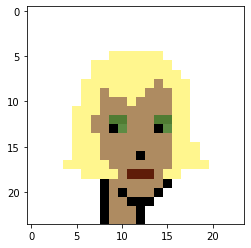

(24, 24, 4) => (24, 24) => (576,)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: FutureWarning: Non RGB image conversion is now deprecated. For RGBA images, please use rgb2gray(rgba2rgb(rgb)) instead. In version 0.19, a ValueError will be raised if input image last dimension length is not 3.
  


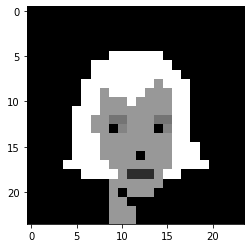

In [ ]:
test_punk_id = 0 # $$$ = 3100
test_punk = og_punks.crop(get_cropbox(test_punk_id))
# TODO: too small. How to show small image large? display(test_punk)
plt.imshow(test_punk, interpolation='nearest', cmap='gray')
plt.show()

test_punk_arrayed = asarray(test_punk)
test_punk_arrayed_grayed = rgb2gray(test_punk_arrayed)
print(test_punk_arrayed.shape, "=>", test_punk_arrayed_grayed.shape, "=>", test_punk_arrayed_grayed.flatten().shape)

plt.imshow(test_punk_arrayed_grayed, interpolation='nearest', cmap='gray')
plt.show()

At this point, each punk is a one dimensional array, which is easy to feed to UMAP. Note that each pixel is now a single float64 in the range [0--1].

In [ ]:
print(test_punk_arrayed_grayed.flatten()[0])
print(test_punk_arrayed_grayed.flatten()[254])
print(type(test_punk_arrayed_grayed.flatten()[254]))


0.0
0.5623894117647059
<class 'numpy.float64'>


In [ ]:
# We need to enumerate all punks as 1D arrays in a 2D array of punks. 
# Row is punk ID, each column is a pixel value.

# TODO: Surely there is some elegant pythonic way of doing this. Later, maybe
number_of_punks = 10000
number_of_pixels = 576

feat_cols = [ 'pixel'+str(i) for i in range(number_of_pixels) ]
#print(feat_cols)

punk_images = np.zeros((10000, number_of_pixels))
print(punk_images.shape)

for x in range(number_of_punks):
    a_punk = og_punks.crop(get_cropbox(x))
    a_punk_grayed = rgb2gray(asarray(a_punk))
    punk_images[x] = a_punk_grayed.flatten()
    
punks = pd.DataFrame(punk_images,columns=feat_cols)
punks

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: FutureWarning: Non RGB image conversion is now deprecated. For RGBA images, please use rgb2gray(rgba2rgb(rgb)) instead. In version 0.19, a ValueError will be raised if input image last dimension length is not 3.
  app.launch_new_instance()


(10000, 576)


,pixel0,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,pixel10,pixel11,pixel12,pixel13,pixel14,pixel15,pixel16,pixel17,pixel18,pixel19,pixel20,pixel21,pixel22,pixel23,pixel24,pixel25,pixel26,pixel27,pixel28,pixel29,pixel30,pixel31,pixel32,pixel33,pixel34,pixel35,pixel36,pixel37,pixel38,pixel39,...,pixel536,pixel537,pixel538,pixel539,pixel540,pixel541,pixel542,pixel543,pixel544,pixel545,pixel546,pixel547,pixel548,pixel549,pixel550,pixel551,pixel552,pixel553,pixel554,pixel555,pixel556,pixel557,pixel558,pixel559,pixel560,pixel561,pixel562,pixel563,pixel564,pixel565,pixel566,pixel567,pixel568,pixel569,pixel570,pixel571,pixel572,pixel573,pixel574,pixel575
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.562389,0.562389,0.562389,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.562389,0.562389,0.562389,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.279112,0.279112,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.279112,0.279112,0.279112,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.715263,0.715263,0.715263,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.715263,0.715263,0.715263,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.279112,0.279112,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.343733,0.343733,0.343733,0.257258,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.279112,0.279112,0.279112,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.562389,0.562389,0.000000,0.000000,0.459378,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.562389,0.562389,0.562389,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.865147,0.865147,0.865147,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.865147,0.865147,0.865147,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9996,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.715263,0.715263,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.715263,0.715263,0.715263,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9997,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.588344,0.588344,0.000000,0.000000,0.000000,0.0,0

In [ ]:
%time embedding = umap.UMAP(n_neighbors=10, min_dist=0.1, n_components=2).fit_transform(punks)

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


CPU times: user 48.7 s, sys: 883 ms, total: 49.6 s
Wall time: 35.3 s


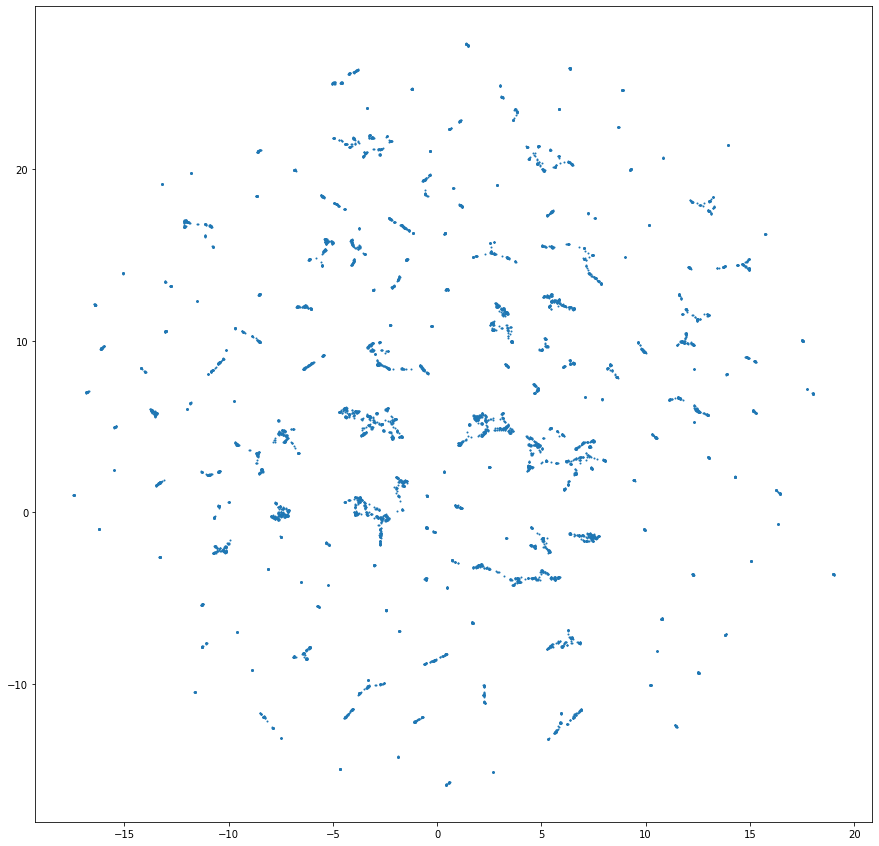

In [ ]:
subset_of_embedding = embedding #[0:100]
fig = plt.figure(figsize=(15, 15))
plt.scatter(subset_of_embedding[:,0], subset_of_embedding[:,1], s=1)
plt.show()

In [ ]:
print(type(embedding))

x_min = np.min(embedding[:,0])
x_max = np.max(embedding[:,0])
x_delta = x_max - x_min

y_min = np.min(embedding[:,1]) 
y_max = np.max(embedding[:,1])
y_delta = y_max - y_min

print(x_min, x_max)
print(y_min, y_max)

#embedding

<class 'numpy.ndarray'>
-17.457495 19.042122
-15.877021 27.333752


In [ ]:
print( trunc((embedding[3100, 0]+20)*20), trunc((embedding[3100, 1]+20)*20) )

606 490


In [ ]:
# Add in ids (as floats unfortunately)
ids = np.arange(number_of_punks)

x_y_ids = np.c_[embedding,ids]

## Visualize Collection

### Static visualization

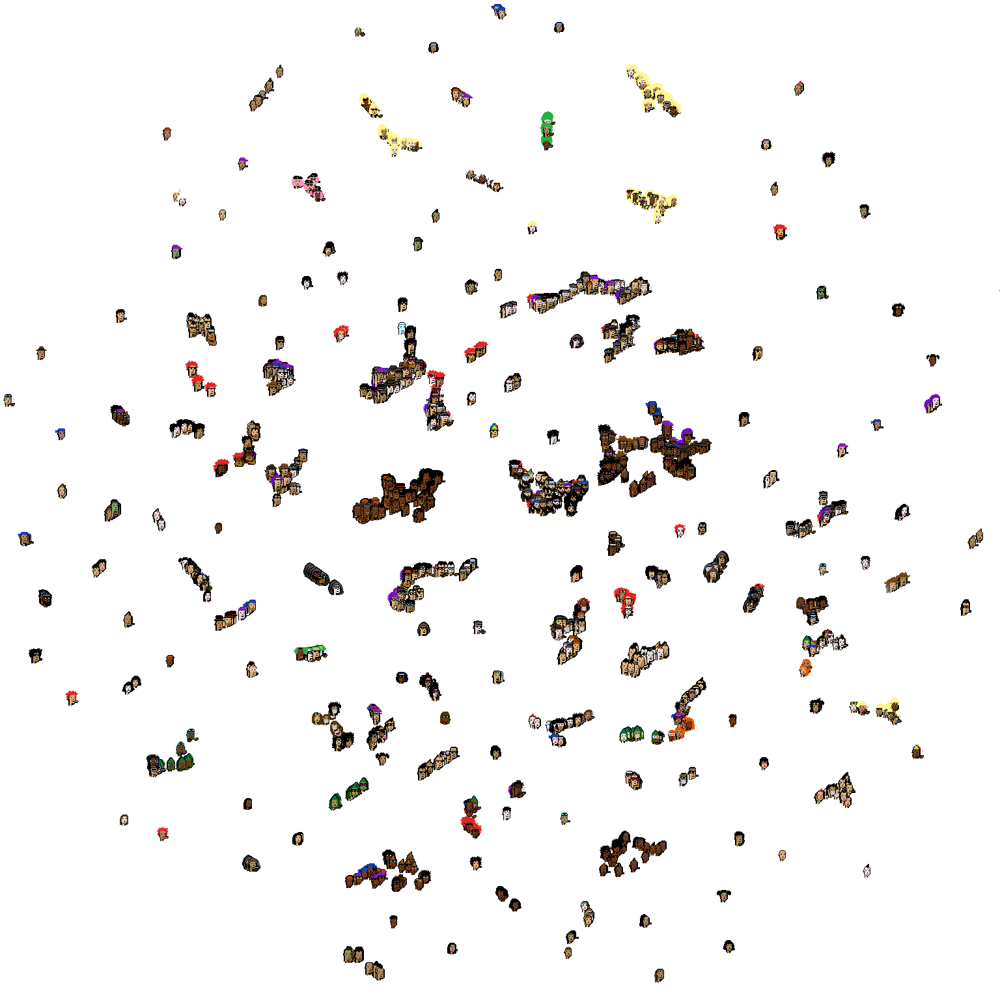

In [ ]:
canvas_dimensions = ((1024+512), (1024+512))
canvas_width = canvas_dimensions[0]
canvas_height = canvas_dimensions[1]

x_factor = canvas_width / x_delta
y_factor = canvas_height / y_delta

embedding_neighborhood = Image.new('RGBA', canvas_dimensions, (0,0,0,0))

def translate_to_canvas(x, y):
  x_dest = trunc((x - x_min) * x_factor)
  y_dest = trunc((y - y_min) * y_factor)
  return (x_dest, y_dest)

# so (coord+20) * 20
for x in range(number_of_punks):
    a_punk = og_punks.crop(get_cropbox(x))
    location = translate_to_canvas(embedding[x,0], embedding[x,1]) #  ( trunc((embedding[x,0]+20)*20) , trunc((embedding[x,1]+20)*20) )
    #print(location)
    embedding_neighborhood.paste(a_punk, location, mask=a_punk)

punk_3100 = og_punks.crop(get_cropbox(3100))
location = ( trunc((embedding[3100,0]+20)*20) , trunc((embedding[3100,1]+20)*20) )
embedding_neighborhood.paste(punk_3100, location, mask=punk_3100)
    
display(embedding_neighborhood)

#d = ImageDraw.Draw(blank_img)


### Interactive visualization

The goal here is to get the images into [TensorBoard Projector](https://projector.tensorflow.org/).

First up, define what we'll be using.

In [ ]:
try:
  # This tensorflow_version is a Colab-only thing
  %tensorflow_version 2.x
except Exception:
  pass

import tensorflow as tf
print("TensorFlow version: ", tf.__version__)

assert version.parse(tf.__version__).release[0] >= 2, \
    "This notebook requires TensorFlow 2.0 or above."

from tensorboard.plugins import projector
%load_ext tensorboard

# TODO: print tensorboard version?

TensorFlow version:  2.7.0


The next step is to torture the images into a format that TensorBoard's Projector can consume. Oddly enough this includes both the NFT images converted to a 1D array, and the original image. The former is for UMAP to chew on and the latter is only for showing us humans the original image, not for number crunching.

In [ ]:
tensorboard_data_dump_dir = '/content/tensorboard_data'
if not os.path.exists(tensorboard_data_dump_dir):
  os.makedirs(tensorboard_data_dump_dir)

vectorized_punks = tf.Variable(punks)

checkpoint = tf.train.Checkpoint(embedding=vectorized_punks)
checkpoint.save(os.path.join(tensorboard_data_dump_dir, 'embedding.ckpt'))

config = projector.ProjectorConfig()
embedder = config.embeddings.add()

embedder.tensor_name = 'embedding/.ATTRIBUTES/VARIABLE_VALUE'

The above is all that is needed to get the images-as-feature-vectors into TensorBoard so that the Projector can embed them in 3D space.

The limitation of the above is that all you see in 3D space is blue dots. We want to see the actual image, which the Projector does not know it already has, as feature vectors, so we also need to give it a sprite sheet PNG for the Projector to plot, instead of just blue dot markers.


References:
- [Taking the TensorBoard Embedding Projector to the Next Level](https://towardsdatascience.com/taking-the-tensorboard-embedding-projector-to-the-next-level-bde53deb6bb7)

In [ ]:
one_square_size = 100 # 10,000 = 100 x 100 in sprite
master_width = 24 * one_square_size # punks are 24x24
master_height = 24 * one_square_size
spriteimage = Image.new(
    mode='RGBA',
    size=(master_width, master_height),
    color=(0,0,0,0) # fully transparent
)

punk_index = 0
for x in range(number_of_punks):
  a_punk = og_punks.crop(get_cropbox(x))
  div, mod = divmod(punk_index, one_square_size)
  #h_loc = 100 * div
  #w_loc = 100 * mod
  h_loc = 24 * div
  w_loc = 24 * mod
  spriteimage.paste(a_punk, (w_loc, h_loc))
  punk_index = punk_index + 1

sprite_filename = os.path.join(tensorboard_data_dump_dir, 'embeddings/sprite.png')

if not os.path.exists(os.path.dirname(sprite_filename)):
  os.makedirs(os.path.dirname(sprite_filename))
#spriteimage.convert("RGB").save(sprite_filename, transparency=0)
spriteimage.save(sprite_filename)

embedder.sprite.image_path = sprite_filename
a_punk_dims = (24, 24)
embedder.sprite.single_image_dim.extend(a_punk_dims)

projector.visualize_embeddings(tensorboard_data_dump_dir, config)

**Bug in TensorBoard launch**

**NOTE:** TensorBoard regular fails to find the data just written to the file syss. If so just rerun the following cell.

Also note that:
- "Fetching tensor values…" normally takes a minute or two
- "Fetching sprite image…" normally takes a minute
- Then PCA will run automatically
- When PCA is done, for UMAP click on UMAP

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir={tensorboard_data_dump_dir}

Reusing TensorBoard on port 6006 (pid 169), started 0:00:54 ago. (Use '!kill 169' to kill it.)

<IPython.core.display.Javascript object>

**History:**
- v1.0.1 (2022-01-11, John Tigue): Added Intro text